In [1]:
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from scipy import signal

In [2]:
classes = ['run', 'walk', 'stand', 'sit', 'sit-to-stand', 'stand-to-sit', 
        'stair-up', 'stair-down', 'jump-one-leg', 'jump-two-leg', 'curve-left-step', 
        'curve-right-step', 'curve-left-spin-Lfirst', 'curve-left-spin-Rfirst', 
        'curve-right-spin-Lfirst', 'curve-right-spin-Rfirst', 'lateral-shuffle-left', 
        'lateral-shuffle-right','v-cut-left-Lfirst', 'v-cut-left-Rfirst', 'v-cut-right-Lfirst', 'v-cut-right-Rfirst']

sensors = ['EMG1', 'EMG2', 'EMG3', 'EMG4', 'Microphone', 'ACC upper X', 'ACC upper Y','ACC upper Z', 'Goniometer X',
          'ACC lower X', 'ACC lower Y', 'ACC lower Z', 'Goniometer Y', 'Gyro upper X', 'Gyro upper Y', 'Gyro upper Z',
          'Gyro lower X', 'Gyro lower Y', 'Gyro lower Z']

data_path = "/Users/thomasklein/Projects/BremenBigDataChallenge2019/bbdc_2019_Bewegungsdaten/"


In [3]:
            
def median_filtering(data, windowsize):
    new_data = []
    for i in np.arange(0,data.shape[0],windowsize):
        new_data.append(np.median(data[i:i+windowsize]))
    return np.array(new_data)
            
def smooth(data, windowsize, std):
    kernel = signal.gaussian(windowsize, std=std)
    kernel /= np.sum(kernel)
    return np.convolve(data, kernel, 'valid')

def variance_filter(data, windowsize):
    half = windowsize//2
    res = np.zeros(data.shape[0]-windowsize)
    for i in range(half,len(data)-half):
        res[i-half] = np.std(data[i-half:i+half])
    return res / np.max(res)

def peakfinder(data, h_thresh, w_thresh, n):
    """
    Finds peaks in a spectrum. Returns the first six peaks as 
    
    location1, location2, ...  location6
    height1,   height2,   ...  height6
    width1,    width2,    ...  width6
    
    The location is normalized so that the location of the first peak corresponds to zero.
    
    arguments: 
        data = 1d-array (of variance intensity values)
        h_thresh = the threshold for the minimum height a peak needs to have
        w_thresh = the threshold for the minimum width a peak needs to have
        n = the number of peaks to extract
    """
    #print(data)
    if h_thresh == None:
        h_thresh = np.mean(data)
        #print("max: ",np.max(data))
        #print("had to change height, new height:",h_thresh)
    locations, properties = signal.find_peaks(data, height=h_thresh, width=w_thresh)
    heights = properties['peak_heights']
    #widths = properties['width_heights']
    left = properties['left_ips']
    right = properties['right_ips']
    results = np.stack((locations,heights,left,right))
    #print(results)
    
    # if no peaks were found, return empty array
    if results.size == 0:
        #print("returning empty array")
        return np.zeros((4,n))
    
    # subtract location of biggest peak to shift everything
    #results[0,:] = results[0,:] - results[0,0]
    
    # sort descending by peak height
    results = results[:,(-results[1,:]).argsort()]
    
    # select biggest n peaks
    results = results[:,0:n]
    
    # rounding to 3 decimal places
    #results = np.round(results,3)

    # if not enough peaks found, fill up with zeros
    if results.shape[1] != n:
        results = np.pad(results,((0,0),(0,n-results.shape[1])),'constant', constant_values=0)
        
    return results
        
        
from scipy import ndimage
def derivative_filter(data, windowsize, std):
    lowpass = smooth(data, windowsize, std)
    deriv = ndimage.sobel(lowpass, 0)
    return deriv
    

In [4]:
def plot_sensor_info_for_label(sensor,label,n):
    df = pd.read_csv(data_path+"train.csv")
    count = 0
    for index, drow in df.iterrows():
        if drow['Label'] == label:
            count += 1
            
            data = pd.read_csv(data_path+drow['Datafile']).values
            
            fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(20,6))
            ax[0].set_title(drow['Subject']+", "+drow['Datafile'][20:31]+", "+label+",  "+sensors[sensor])
            ax[1].set_title("Variance spectrum and peaks")
            #ax[0].set_ylim(0,50000)
            plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=.5)
            
            xs = np.arange(0,data.shape[0])
            ax[0].plot(xs,data[:,sensor])
            
            vari = smooth(variance_filter(data[:,sensor],windowsize=100),100,25)
            #deriv = derivative_filter(data[:,sensor],windowsize=200, std=50)
            #peaks = signal.find_peaks(vari, height=None, width=20)
            #testres = peakfinder(deriv, None, 20, 3)
            #ax[1].scatter(peaks[0],vari[peaks[0]], c="r")
            ax[1].plot(np.arange(0,vari.shape[0]),vari, c="g")
            samples = [int(sample) for sample in np.linspace(0, vari.shape[0]-1, 80)]
            ax[1].scatter(samples,vari[samples])
            #ax[1].scatter(peaks[0],deriv[peaks[0]], c="r")
            #ax[1].plot(np.arange(0,deriv.shape[0]),np.ones(deriv.shape[0])*np.mean(deriv), c="blue")
            #ax[1].plot(np.arange(0,deriv.shape[0]),deriv, c="g")
            ax[1].set_ylim(0,1)
            plt.show()
            if count == n:
                break

# EMG1 : variance-filter ohne norm, window=200, dann smoothen mit w=200 und sigma=50
# EMG2 : varfilter ohne norm, w=100, smoothen mit w=100 und sigma=25
# Goniometer einfach smoothen
# Gyro auch einfach smoothen
# => zwei Klassen von Signalen??
# Ja: Varianzanalyse für: EMG1 bis 4, Microphone, smoothing für alles andere

In [ ]:
for label in classes:    
    plot_sensor_info_for_label(sensors.index('Gyro upper X'),label,10)

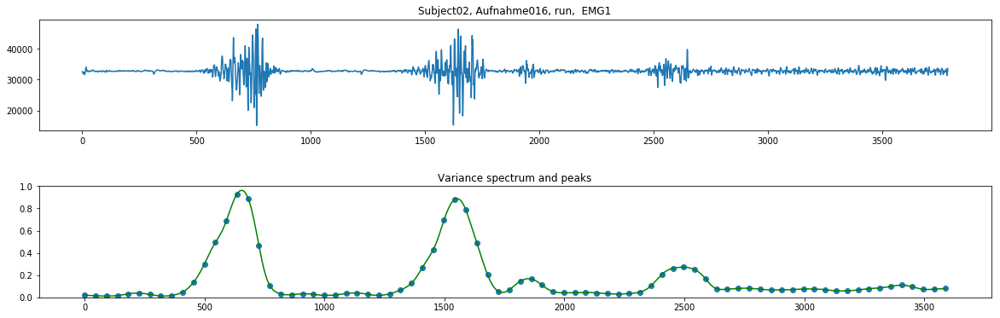

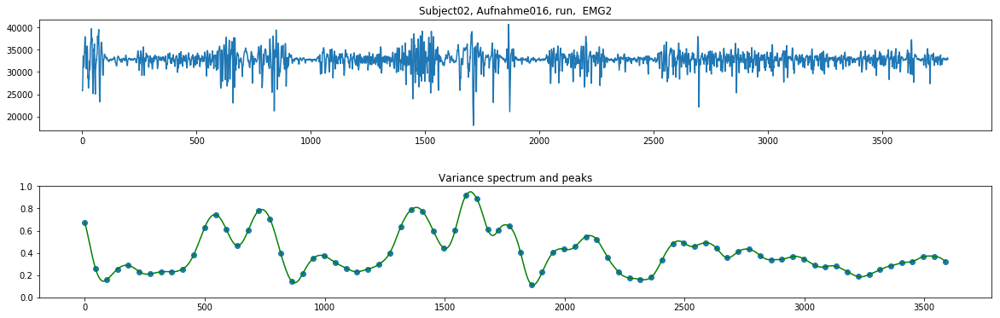

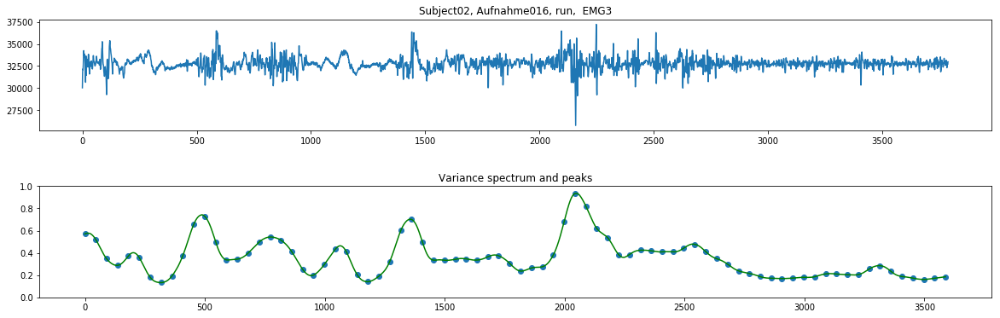

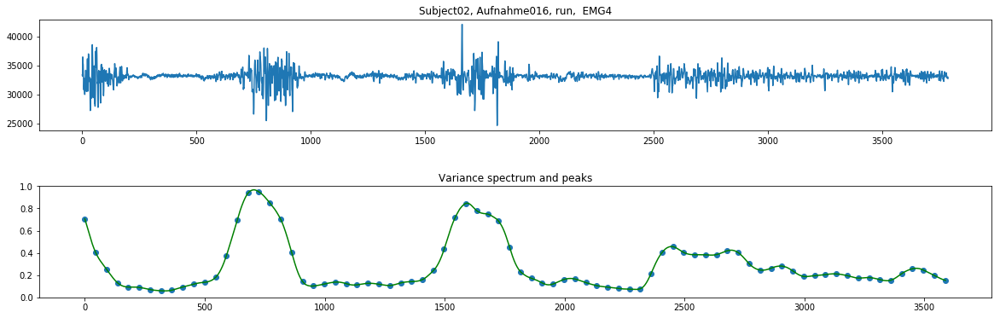

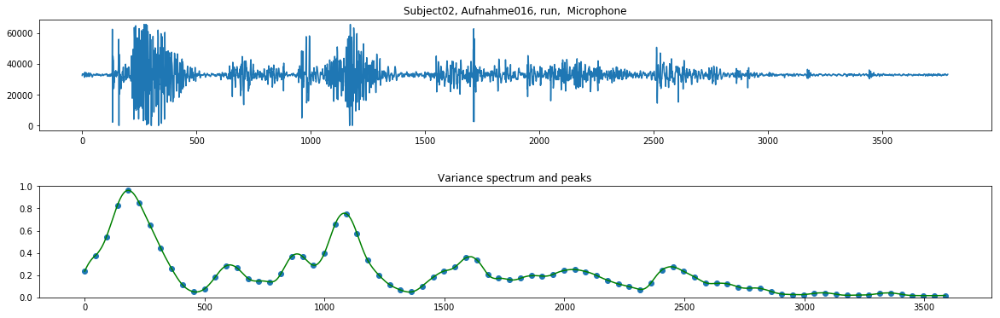

...

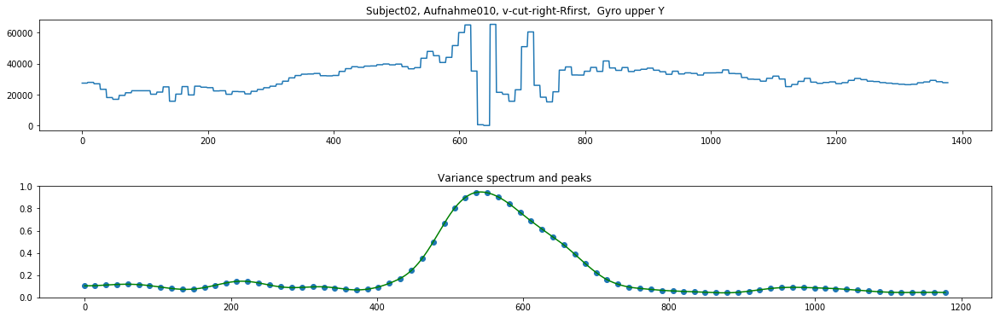

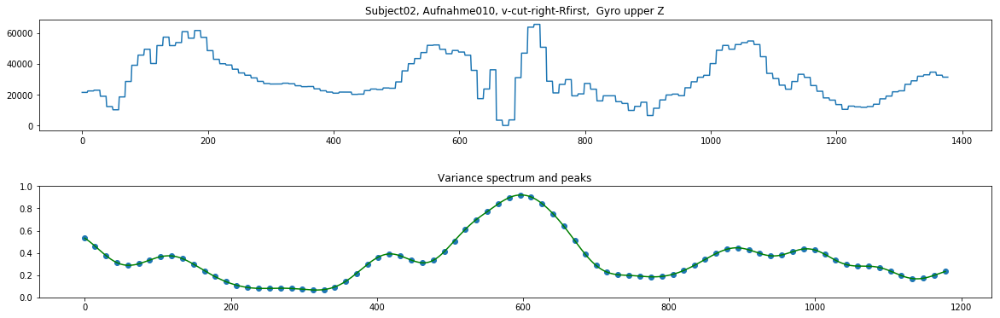

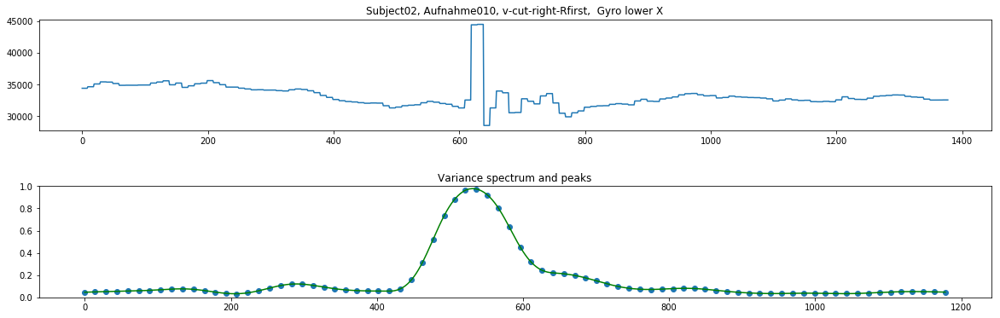

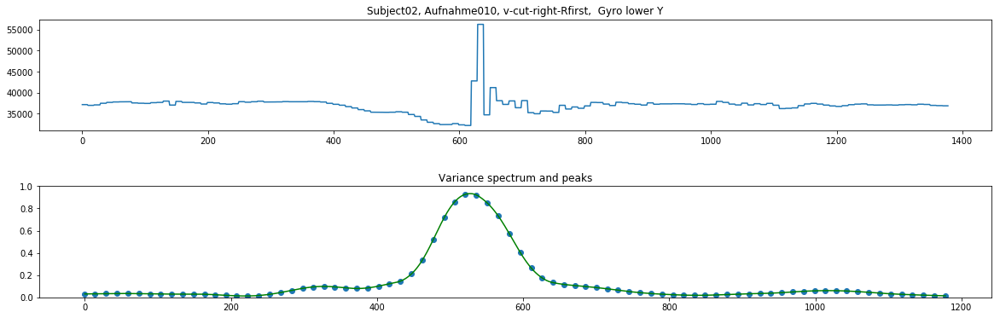

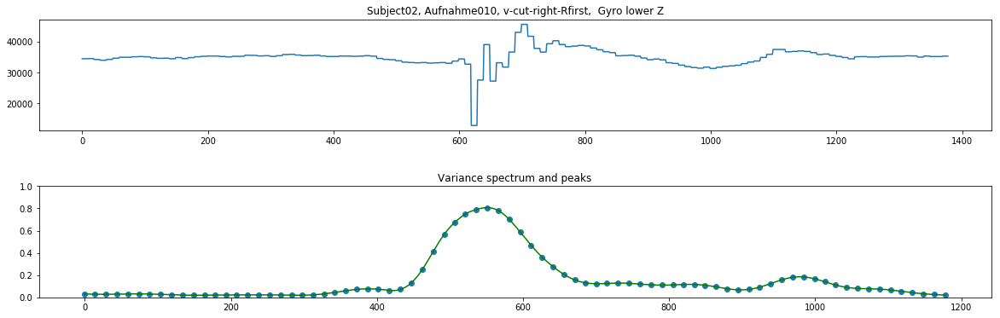

In [7]:
for c in classes:
    for s in sensors:
        plot_sensor_info_for_label(sensors.index(s),c,1)